In [464]:
import numpy as np
import libpysal as ps
import missingno as msno
from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
import geopandas as gp
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import matplotlib.font_manager as fm
from matplotlib import font_manager, rc
import seaborn as sns
import warnings
from mgwr.utils import shift_colormap, truncate_colormap

mpl.rcParams['axes.unicode_minus'] = False
warnings.simplefilter('ignore')

from tqdm import tqdm_notebook

from sklearn.model_selection import KFold, StratifiedKFold

warnings.simplefilter('ignore')

font_path = r'C:/Users/user/NanumFontSetup_TTF_ALL/NanumGothic.ttf'
font_name = font_manager.FontProperties(fname=font_path, size=18).get_name()
rc('font',family=font_name)

In [465]:
ped_data = pd.read_csv('./서울시_집계구_보행수요_최종.csv',encoding="EUC-KR")
road_data = pd.read_csv('./서울시_도로_보행수요_최종.csv',encoding="EUC-KR")
seoul_shp = gp.read_file('./data/서울시 행정구역 및 집계구 정보(SHP)/서울시_집계구_4326.shp',encoding="EUC-KR")

# pop_data = pd.read_csv('./data/pop/19년 12월 집계구코드별 평균생활인구수.csv')

In [466]:
ped_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19153 entries, 0 to 19152
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   TOT_REG_CD  19153 non-null  int64  
 1   공공기관        19153 non-null  int64  
 2   보육시설        19153 non-null  int64  
 3   사회복지시       19153 non-null  int64  
 4   버스정류장수      19153 non-null  int64  
 5   버스승하차       19153 non-null  float64
 6   지하철(1km이내)  19153 non-null  int64  
 7   지하철거리점수     19143 non-null  float64
 8   지하철승하차      19153 non-null  int64  
 9   구별총생활       19153 non-null  int64  
 10  구별총생활인구     19153 non-null  float64
 11  상가수         19143 non-null  float64
 12  어린이집개수      18738 non-null  float64
 13  면적          19153 non-null  int64  
dtypes: float64(5), int64(9)
memory usage: 2.0 MB


In [467]:
road_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67530 entries, 0 to 67529
Data columns (total 15 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   도로번호     67530 non-null  int64  
 1   도로길이     67530 non-null  float64
 2   공공기관     67530 non-null  int64  
 3   보육시설     67530 non-null  int64  
 4   사회복지시설   67530 non-null  int64  
 5   상권정보     67530 non-null  int64  
 6   버스정류장수   67530 non-null  int64  
 7   버스승하차    67530 non-null  float64
 8   지하철수     67530 non-null  int64  
 9   지하철승하차   67530 non-null  int64  
 10  지하철거리점수  67530 non-null  float64
 11  어린이집     67530 non-null  int64  
 12  시설수      67530 non-null  int64  
 13  X        67530 non-null  float64
 14  Y        67530 non-null  float64
dtypes: float64(5), int64(10)
memory usage: 7.7 MB


In [468]:
seoul_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 19153 entries, 0 to 19152
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   TOT_REG_CD  19153 non-null  object  
 1   ADM_NM      19153 non-null  object  
 2   ADM_CD      19153 non-null  object  
 3   geometry    19153 non-null  geometry
dtypes: geometry(1), object(3)
memory usage: 598.7+ KB


In [469]:
seoul_shp.to_crs(epsg=4326)
seoul_shp.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Column명 변경
- 사회복지시 -> SOC_NUM
- 지하철(1km이내) -> SUB_NUM
- 지하철거리점수 -> SUB_DIS_POINT
- 버스정류장수 -> BUS_NUM
- 버스승하차 -> BUS_AVG
- 지하철승하차 -> SUB_AVG
- 구별총생활 -> TOT_POP_GU
- 구별총생활인구 -> TOT_POP_GU_AVG
- 상가수 -> SHOP_NUM
- 어린이집개수 -> CHILD_NUM
- 면적 -> AREA

TARGET VARIABLE : TOT_POP_GU_AVG

In [470]:
ped_data.rename(columns={'사회복지시':'SOC_NUM','지하철(1km이내)':'SUB_NUM','지하철거리점수':'SUB_DIS_POINT'
                         ,'버스정류장수':'BUS_NUM','버스승하차':'BUS_AVG','지하철승하차':'SUB_AVG'
                         ,'구별총생활':'TOT_POP_GU','구별총생활인구':'TOT_POP_GU_AVG','상가수':'SHOP_NUM'
                        , '어린이집개수':'CHILD_NUM','면적':'AREA'}
                        ,inplace=True)      
road_data.rename(columns={'사회복지시설':'SOC_NUM','지하철수':'SUB_NUM','지하철거리점수':'SUB_DIS_POINT'
                         ,'버스정류장수':'BUS_NUM','버스승하차':'BUS_AVG','지하철승하차':'SUB_AVG'
                         ,'구별총생활':'TOT_POP_GU','구별총생활인구':'TOT_POP_GU_AVG','상권정보':'SHOP_NUM'
                        , '어린이집':'CHILD_NUM','시설수':'FACILITY_NUM'}
                        ,inplace=True) 
display(ped_data.columns)
display(road_data.columns)

Index(['TOT_REG_CD', '공공기관', '보육시설', 'SOC_NUM', 'BUS_NUM', 'BUS_AVG',
       'SUB_NUM', 'SUB_DIS_POINT', 'SUB_AVG', 'TOT_POP_GU', 'TOT_POP_GU_AVG',
       'SHOP_NUM', 'CHILD_NUM', 'AREA'],
      dtype='object')

Index(['도로번호', '도로길이', '공공기관', '보육시설', 'SOC_NUM', 'SHOP_NUM', 'BUS_NUM',
       'BUS_AVG', 'SUB_NUM', 'SUB_AVG', 'SUB_DIS_POINT', 'CHILD_NUM',
       'FACILITY_NUM', 'X', 'Y'],
      dtype='object')

### 결측치 확인 및 제거
- 상점의 수에 nan이 존재하여 0으로 대체

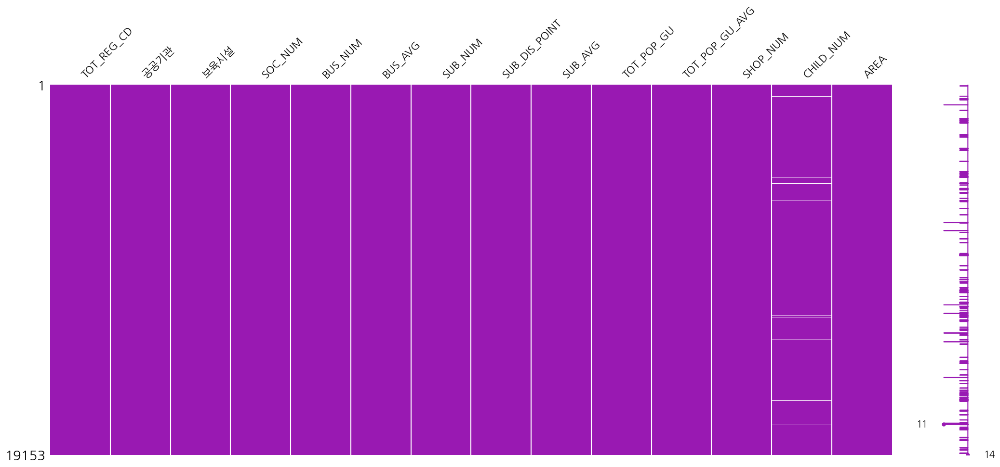

In [471]:
msno.matrix(df=ped_data,color=(0.6,0.1,0.7))
plt.show()

In [472]:
ped_data.isnull().sum()

TOT_REG_CD          0
공공기관                0
보육시설                0
SOC_NUM             0
BUS_NUM             0
BUS_AVG             0
SUB_NUM             0
SUB_DIS_POINT      10
SUB_AVG             0
TOT_POP_GU          0
TOT_POP_GU_AVG      0
SHOP_NUM           10
CHILD_NUM         415
AREA                0
dtype: int64

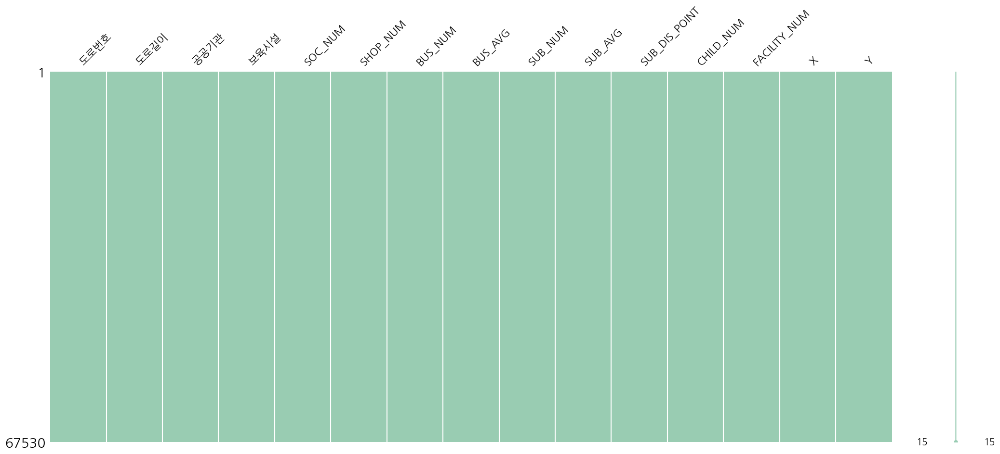

In [473]:
msno.matrix(df=road_data,color=(0.6,0.8,0.7))
plt.show()

In [474]:
road_data.isnull().sum()

도로번호             0
도로길이             0
공공기관             0
보육시설             0
SOC_NUM          0
SHOP_NUM         0
BUS_NUM          0
BUS_AVG          0
SUB_NUM          0
SUB_AVG          0
SUB_DIS_POINT    0
CHILD_NUM        0
FACILITY_NUM     0
X                0
Y                0
dtype: int64

#### 1. 지하철 거리 점수
- 0으로 대체

In [475]:
sub_dis_point_agg = ped_data['SUB_DIS_POINT'].agg(['mean'])
sub_dis_point_agg

mean    24.445437
Name: SUB_DIS_POINT, dtype: float64

sns.histplot(data=ped_data,x='SUB_DIS_POINT',color='blue',kde=True,element='poly')
plt.show()

In [476]:
ped_data['SUB_DIS_POINT'].fillna(0,inplace=True)
ped_data['SUB_DIS_POINT'].isnull().sum()

0

#### 2. 상점수

In [477]:
ped_data['SHOP_NUM'].fillna(0,inplace=True)
ped_data['SHOP_NUM'].isnull().sum()

0

#### 3. 어린이집 개수

In [478]:
ped_data['CHILD_NUM'].fillna(0,inplace=True)
ped_data['SHOP_NUM'].isnull().sum()

0

In [479]:
ped_data.isnull().sum()

TOT_REG_CD        0
공공기관              0
보육시설              0
SOC_NUM           0
BUS_NUM           0
BUS_AVG           0
SUB_NUM           0
SUB_DIS_POINT     0
SUB_AVG           0
TOT_POP_GU        0
TOT_POP_GU_AVG    0
SHOP_NUM          0
CHILD_NUM         0
AREA              0
dtype: int64

### Column 생성
1. 면적 당 상가 수 = 상가 수 / 면적
2. 면적 당 시설 수 = 시설 수(어린이집, 공공기관, 보육시설, SOC_NUM) / 면적
3. 면적 당 버스정류장 = 정류장수 / 면적
4. 면적 당 지하철 수 = 지하철 수 / 면적
5. 면적 당 생활인구 수 = 구별총생활인구수 평균 / 면적

In [480]:
ped_data['FACILITY_NUM'] = (ped_data['공공기관']+ped_data['보육시설']+ped_data['CHILD_NUM']+ped_data['SOC_NUM'])

In [481]:
ped_data.head()

,TOT_REG_CD,공공기관,보육시설,SOC_NUM,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,TOT_POP_GU,TOT_POP_GU_AVG,SHOP_NUM,CHILD_NUM,AREA,FACILITY_NUM
0,1101053010001,6,4,0,3,196.559140,4,24.0,0,277143,8940.096774,7.0,6.0,18821,16.0
1,1101053010002,7,2,0,2,428.177419,3,27.0,52315,1373417,44303.774190,74.0,7.0,37082,16.0
2,1101053010003,10,6,0,12,497.196237,4,26.0,34690,1245899,40190.290320,37.0,10.0,218981,26.0
3,1101053010004,10,2,0,5,3152.083871,4,29.0,52315,1515584,48889.806450,113.0,10.0,44920,22.0
4,1101053010005,11,2,0,6,2136.021505,3,29.0,52315,1038484,33499.483870,122.0,11.0,70996,24.0


In [482]:
# 현재 TOT_REG_CD가 int type이므로 str type으로 변경해주도록 한다.
# 차후 merge를 하기 위해서이다.
ped_data['TOT_REG_CD']= ped_data['TOT_REG_CD'].astype(str)

In [483]:
# prepare dataset
data = ped_data.merge(seoul_shp,left_on='TOT_REG_CD',right_on='TOT_REG_CD')
data.head()

,TOT_REG_CD,공공기관,보육시설,SOC_NUM,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,TOT_POP_GU,TOT_POP_GU_AVG,SHOP_NUM,CHILD_NUM,AREA,FACILITY_NUM,ADM_NM,ADM_CD,geometry
0,1101053010001,6,4,0,3,196.559140,4,24.0,0,277143,8940.096774,7.0,6.0,18821,16.0,사직동,1101053,"POLYGON ((126.96613 37.57496, 126.96632 37.574..."
1,1101053010002,7,2,0,2,428.177419,3,27.0,52315,1373417,44303.774190,74.0,7.0,37082,16.0,사직동,1101053,"POLYGON ((126.96877 37.57823, 126.96878 37.578..."
2,1101053010003,10,6,0,12,497.196237,4,26.0,34690,1245899,40190.290320,37.0,10.0,218981,26.0,사직동,1101053,"POLYGON ((126.96645 37.57883, 126.96647 37.578..."
3,1101053010004,10,2,0,5,3152.083871,4,29.0,52315,1515584,48889.806450,113.0,10.0,44920,22.0,사직동,1101053,"POLYGON ((126.97145 37.57734, 126.97147 37.577..."
4,1101053010005,11,2,0,6,2136.021505,3,29.0,52315,1038484,33499.483870,122.0,11.0,70996,24.0,사직동,1101053,"POLYGON ((126.97399 37.57823, 126.97400 37.578..."


In [484]:
# essential_col=['TOT_REG_CD','공공기관','보육시설','SOC_NUM','BUS_NUM','BUS_AVG','SUB_NUM','SUB_DIS','SUB_AVG'
#                ,'SHOP_NUM','geometry','TOT_POP_GU_AVG']
essential_col=['TOT_REG_CD','BUS_NUM','BUS_AVG','SUB_NUM','SUB_DIS_POINT','SUB_AVG'
               ,'SHOP_NUM','FACILITY_NUM','geometry','TOT_POP_GU_AVG']
# essential_col=['TOT_REG_CD','BUS_NUM','SUB_NUM','SUB_DIS_POINT'
#                ,'SHOP_NUM','FACILITY_NUM','geometry','TOT_POP_GU_AVG']
required_data = data.loc[:,essential_col]
required_data.head()

,TOT_REG_CD,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,SHOP_NUM,FACILITY_NUM,geometry,TOT_POP_GU_AVG
0,1101053010001,3,196.559140,4,24.0,0,7.0,16.0,"POLYGON ((126.96613 37.57496, 126.96632 37.574...",8940.096774
1,1101053010002,2,428.177419,3,27.0,52315,74.0,16.0,"POLYGON ((126.96877 37.57823, 126.96878 37.578...",44303.774190
2,1101053010003,12,497.196237,4,26.0,34690,37.0,26.0,"POLYGON ((126.96645 37.57883, 126.96647 37.578...",40190.290320
3,1101053010004,5,3152.083871,4,29.0,52315,113.0,22.0,"POLYGON ((126.97145 37.57734, 126.97147 37.577...",48889.806450
4,1101053010005,6,2136.021505,3,29.0,52315,122.0,24.0,"POLYGON ((126.97399 37.57823, 126.97400 37.578...",33499.483870


### 데이터 분포 확인
#### 1. 지하철 거리

#### 2. 버스 승하차
- 왼쪽으로 치우친 형태의 분포를 띄고 있다. 
- log함수를 이용하여 skew된 분포를 정규분포형태로 만들어주자.

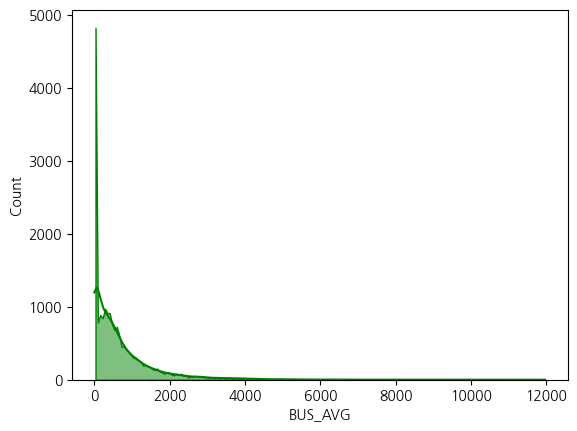

In [65]:
sns.histplot(data=ped_data,x='BUS_AVG',element="poly",color='green',kde=True)
plt.show()

#### 3. 지하철 평균
- 왼쪽으로 치우친 분포를 보이고 있다.
- log함수를 이용하여 정규분포 형태를 만들어주자.

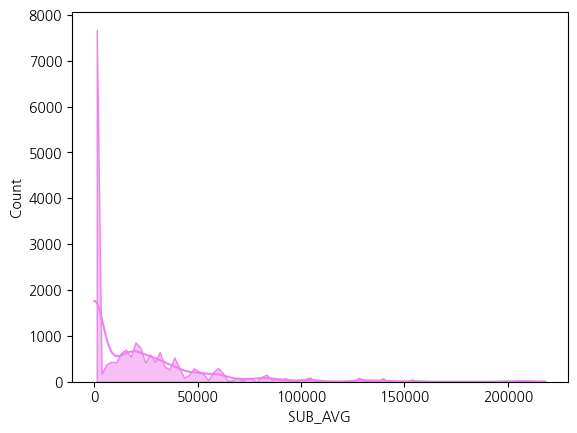

In [66]:
sns.histplot(data=ped_data,x='SUB_AVG',color='violet',element="poly",kde=True)
plt.show()

#### 4. 상가 밀도
- skew한 분포를 보이고 있다. log1p를 취해주도록 한다.


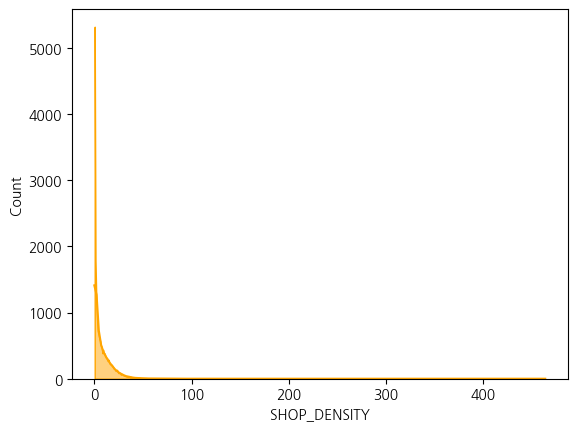

In [67]:
sns.histplot(data=ped_data,x='SHOP_DENSITY',color='orange',element="poly",kde=True)
plt.show()

#### 5. 구별총생활인구수 평균 밀도

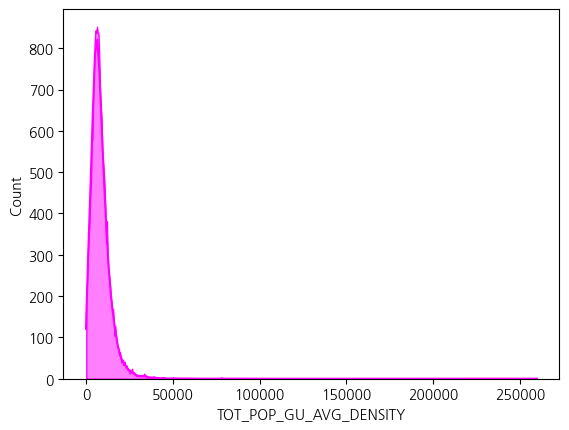

In [68]:
sns.histplot(data=ped_data,x='TOT_POP_GU_AVG_DENSITY',color='magenta',element="poly",kde=True)
plt.show()

#### 6. 시설 밀도

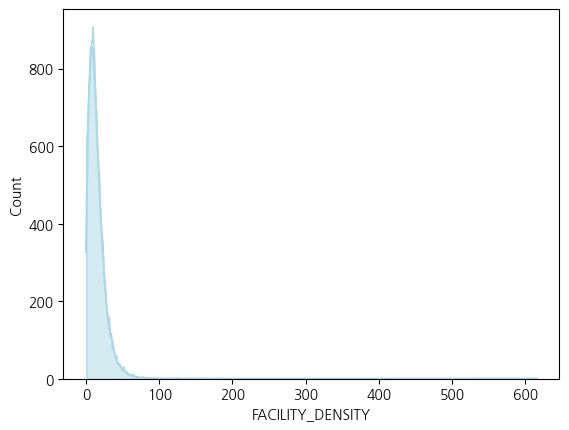

In [82]:
sns.histplot(data=ped_data,x='FACILITY_DENSITY',color='lightblue',element="poly",kde=True)
plt.show()

In [149]:
# 현재 TOT_REG_CD가 int type이므로 str type으로 변경해주도록 한다.
# 차후 merge를 하기 위해서이다.
ped_data['TOT_REG_CD']= ped_data['TOT_REG_CD'].astype(str)

In [150]:
# prepare dataset
data = ped_data.merge(seoul_shp,left_on='TOT_REG_CD',right_on='TOT_REG_CD')
data.head()

,TOT_REG_CD,ADM_NM_x,ADM_CD_x,공공기관,보육시설,SOC_NUM,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,TOT_POP_GU,TOT_POP_GU_AVG,SHOP_NUM,CHILD_NUM,AREA,FACILITY_NUM,ADM_NM_y,ADM_CD_y,geometry
0,1101053010001,사직동,1101053,6,4,0,5,140,4,24.0,0,277143,8940.096774,7.0,6.0,18821,16.0,사직동,1101053,"POLYGON ((126.96613 37.57496, 126.96632 37.574..."
1,1101053010002,사직동,1101053,7,2,0,4,1390,3,27.0,52315,1373417,44303.774190,74.0,7.0,37082,16.0,사직동,1101053,"POLYGON ((126.96877 37.57823, 126.96878 37.578..."
2,1101053010003,사직동,1101053,10,6,0,13,492,4,26.0,34690,1245899,40190.290320,37.0,10.0,218981,26.0,사직동,1101053,"POLYGON ((126.96645 37.57883, 126.96647 37.578..."
3,1101053010004,사직동,1101053,10,2,0,7,3171,4,29.0,52315,1515584,48889.806450,113.0,10.0,44920,22.0,사직동,1101053,"POLYGON ((126.97145 37.57734, 126.97147 37.577..."
4,1101053010005,사직동,1101053,11,2,0,7,2165,3,29.0,52315,1038484,33499.483870,122.0,11.0,70996,24.0,사직동,1101053,"POLYGON ((126.97399 37.57823, 126.97400 37.578..."


In [151]:
data.columns

Index(['TOT_REG_CD', 'ADM_NM_x', 'ADM_CD_x', '공공기관', '보육시설', 'SOC_NUM',
       'BUS_NUM', 'BUS_AVG', 'SUB_NUM', 'SUB_DIS_POINT', 'SUB_AVG',
       'TOT_POP_GU', 'TOT_POP_GU_AVG', 'SHOP_NUM', 'CHILD_NUM', 'AREA',
       'FACILITY_NUM', 'ADM_NM_y', 'ADM_CD_y', 'geometry'],
      dtype='object')

In [152]:
essential_col=['TOT_REG_CD','BUS_NUM','BUS_AVG','SUB_NUM','SUB_DIS_POINT','SUB_AVG'
               ,'SHOP_NUM','FACILITY_NUM','geometry','TOT_POP_GU_AVG']
required_data = data.loc[:,essential_col]
required_data.head()

,TOT_REG_CD,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,SHOP_NUM,FACILITY_NUM,geometry,TOT_POP_GU_AVG
0,1101053010001,5,140,4,24.0,0,7.0,16.0,"POLYGON ((126.96613 37.57496, 126.96632 37.574...",8940.096774
1,1101053010002,4,1390,3,27.0,52315,74.0,16.0,"POLYGON ((126.96877 37.57823, 126.96878 37.578...",44303.774190
2,1101053010003,13,492,4,26.0,34690,37.0,26.0,"POLYGON ((126.96645 37.57883, 126.96647 37.578...",40190.290320
3,1101053010004,7,3171,4,29.0,52315,113.0,22.0,"POLYGON ((126.97145 37.57734, 126.97147 37.577...",48889.806450
4,1101053010005,7,2165,3,29.0,52315,122.0,24.0,"POLYGON ((126.97399 37.57823, 126.97400 37.578...",33499.483870


### Data 분포 변환

#### 1. 버스 이용객 평균

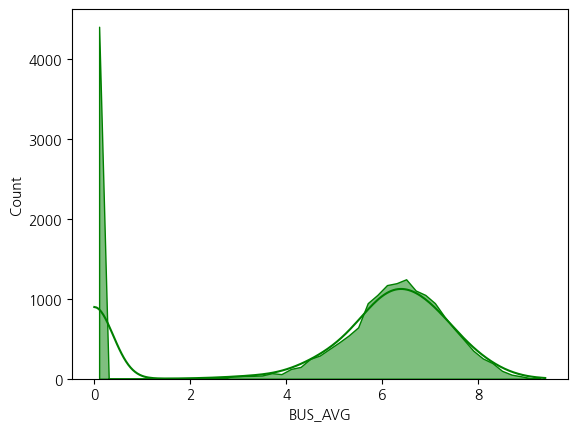

In [84]:
required_data.loc[:,'BUS_AVG'] = np.log1p(data['BUS_AVG'])
sns.histplot(data=required_data,x='BUS_AVG',element="poly",color='green',kde=True)
plt.show()

#### 2. 지하철 이용객 평균

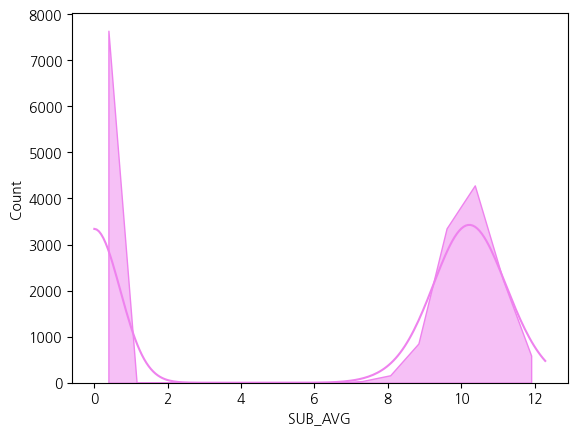

In [85]:
required_data.loc[:,'SUB_AVG'] = np.log1p(data['SUB_AVG'])
sns.histplot(data=required_data,x='SUB_AVG',color='violet',element="poly",kde=True)
plt.show()

#### 3. 상가 밀도

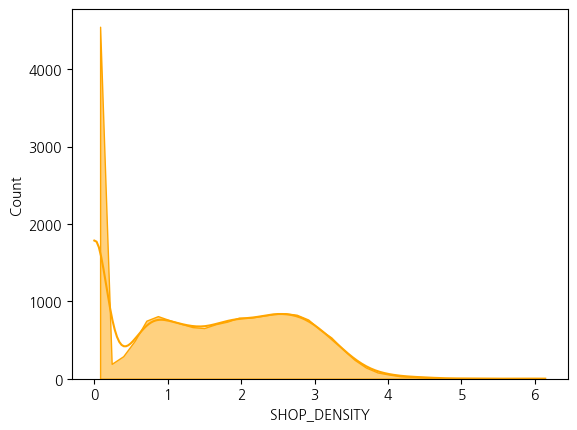

In [86]:
required_data.loc[:,'SHOP_DENSITY'] = np.log1p(data['SHOP_DENSITY'])
sns.histplot(data=required_data,x='SHOP_DENSITY',color='orange',element="poly",kde=True)
plt.show()

#### 4. 구별 총 생활인구 평균 밀도

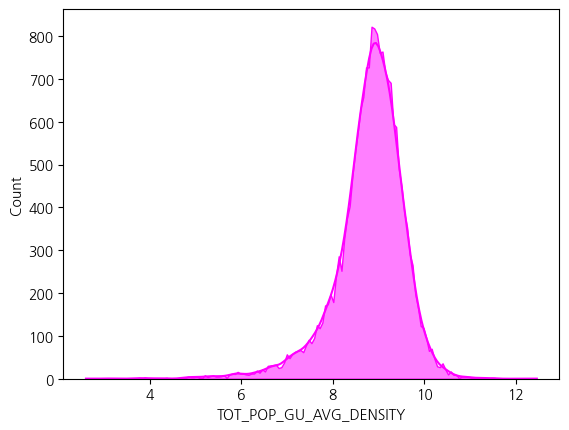

In [87]:
required_data.loc[:,'TOT_POP_GU_AVG_DENSITY'] = np.log1p(data['TOT_POP_GU_AVG_DENSITY'])
sns.histplot(data=required_data,x='TOT_POP_GU_AVG_DENSITY',color='magenta',element="poly",kde=True)
plt.show()

#### 5. 시설 밀도

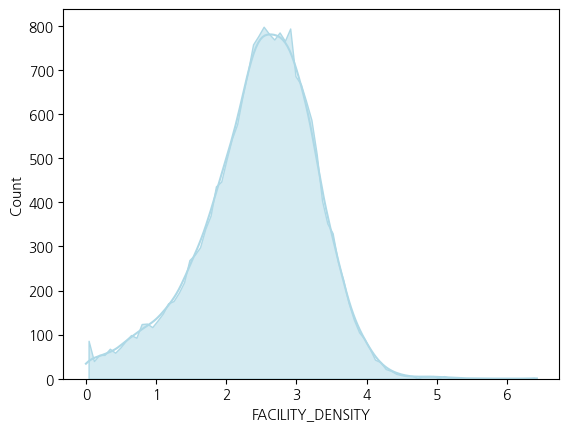

In [88]:
required_data.loc[:,'FACILITY_DENSITY'] = np.log1p(data['FACILITY_DENSITY'])
sns.histplot(data=required_data,x='FACILITY_DENSITY',color='lightblue',element="poly",kde=True)
plt.show()

In [486]:
center = seoul_shp.centroid
X = pd.Series(center.x)
Y = pd.Series(center.y)
required_data.loc[:,'lon'] = X
required_data.loc[:,'lat'] = Y
required_data.head()

,TOT_REG_CD,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,SHOP_NUM,FACILITY_NUM,geometry,TOT_POP_GU_AVG,lon,lat
0,1101053010001,3,196.559140,4,24.0,0,7.0,16.0,"POLYGON ((126.96613 37.57496, 126.96632 37.574...",8940.096774,126.970311,37.578304
1,1101053010002,2,428.177419,3,27.0,52315,74.0,16.0,"POLYGON ((126.96877 37.57823, 126.96878 37.578...",44303.774190,126.965178,37.574151
2,1101053010003,12,497.196237,4,26.0,34690,37.0,26.0,"POLYGON ((126.96645 37.57883, 126.96647 37.578...",40190.290320,126.965513,37.576513
3,1101053010004,5,3152.083871,4,29.0,52315,113.0,22.0,"POLYGON ((126.97145 37.57734, 126.97147 37.577...",48889.806450,126.969002,37.577092
4,1101053010005,6,2136.021505,3,29.0,52315,122.0,24.0,"POLYGON ((126.97399 37.57823, 126.97400 37.578...",33499.483870,126.972772,37.578025


### 독립변수, 종속변수 설정

In [487]:
essential_col[1:-2]

['BUS_NUM',
 'BUS_AVG',
 'SUB_NUM',
 'SUB_DIS_POINT',
 'SUB_AVG',
 'SHOP_NUM',
 'FACILITY_NUM']

In [488]:
road_data.columns

Index(['도로번호', '도로길이', '공공기관', '보육시설', 'SOC_NUM', 'SHOP_NUM', 'BUS_NUM',
       'BUS_AVG', 'SUB_NUM', 'SUB_AVG', 'SUB_DIS_POINT', 'CHILD_NUM',
       'FACILITY_NUM', 'X', 'Y'],
      dtype='object')

In [489]:
#Prepare Georgia dataset inputs
s_y = required_data['TOT_POP_GU_AVG'].values.reshape((-1,1))
s_X = required_data[essential_col[1:-2]].values
u = required_data['lon']
v = required_data['lat']
s_coords = list(zip(u,v))

# p_y = road_data['TOT_POP_GU_AVG'].values.reshape((-1,1))
p_X = road_data[essential_col[1:-2]]
p_u = road_data['X']
p_y = road_data['Y']
p_coords = list(zip(p_u,p_y))

### Modeling

In [490]:
#Calibrate GWR model
gwr_selector = Sel_BW(s_coords, s_y, s_X,kernel='gaussian')
gwr_bw = gwr_selector.search(bw_min=2)
print(gwr_bw)
gwr_model = GWR(s_coords, s_y, s_X, gwr_bw,kernel='gaussian')
gwr_results = gwr_model.fit()

16.0


In [491]:
gwr_results.params[0:5]

array([[ 5.08365371e+04,  1.85003676e+03, -5.96379614e+00,
         4.68335583e+03, -2.60906869e+03,  7.25998318e-02,
         5.13986244e+02,  6.37238197e+01],
       [ 4.01174781e+03,  1.21318223e+03, -3.60957783e+00,
         6.37545589e+02,  1.74454535e+02, -2.80245207e-02,
         5.66073602e+02, -4.15983042e+02],
       [ 6.52255609e+03,  1.47767105e+03, -4.42431023e+00,
         1.91968460e+03, -1.37138138e+01, -2.84766144e-02,
         5.04469143e+02, -4.45812843e+02],
       [ 4.58060231e+04,  1.98784289e+03, -6.53259885e+00,
         3.62611747e+03, -2.05521589e+03,  4.50101977e-02,
         5.66854722e+02, -3.07571103e+02],
       [ 3.36810940e+04,  2.29435668e+03, -4.07392388e+00,
         4.91317878e+03, -2.11418504e+03, -1.41895332e-02,
         4.40463265e+02,  4.30364526e+02]])

In [492]:
gwr_results.localR2[0:10]

array([[0.93346143],
       [0.91350484],
       [0.90669515],
       [0.93765576],
       [0.9345082 ],
       [0.94905938],
       [0.94311382],
       [0.93310973],
       [0.93164195],
       [0.91176664]])

In [493]:
gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                               19153
Number of covariates:                                                     8

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                       4035145938216.688
Log-likelihood:                                                 -210718.682
AIC:                                                             421453.364
AICc:                                                            421455.374
BIC:                                                           4035145749442.878
R2:                                                                   0.573
Adj. R2:                                                              0.573

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- -------

- train data보다 test data set이 크면 안된다
- 개발자 잘못이다.

In [494]:
result = np.array([])
div_num = int(len(road_data)/len(s_X))+1
batch_size = int(len(road_data) / div_num)+1

for idx in range(0,div_num):
    scale = gwr_results.scale
    residuals = gwr_results.resid_response
    # test data로 예측을 해보고 결과 저장
    start_idx = batch_size*idx
    if batch_size*(idx+1) > len(road_data):
        end_idx = len(road_data)
    else:
        end_idx = batch_size*(idx+1)
        
    local_p_coords = p_coords[start_idx:end_idx]
    local_p_X = p_X.iloc[start_idx:end_idx]
    pred_results = gwr_model.predict(np.array(local_p_coords), local_p_X, scale, residuals)
    display(start_idx,end_idx)
    result = np.append(result,pred_results.predictions.flatten())
#     display(result)
#     display(len(result))

result = result.reshape((-1,1))

0

16883

16883

33766

33766

50649

50649

67530

In [495]:
len(result[result<0])
print('0보다 작은 예측값의 비율 : {:.3f}%'.format(len(result[result<0])/len(road_data)*100))

0보다 작은 예측값의 비율 : 7.340%


In [496]:
road_data['EXPECTED_POP_AVG']= pd.Series(result.flatten())
road_data.head()

,도로번호,도로길이,공공기관,보육시설,SOC_NUM,SHOP_NUM,BUS_NUM,BUS_AVG,SUB_NUM,SUB_AVG,SUB_DIS_POINT,CHILD_NUM,FACILITY_NUM,X,Y,EXPECTED_POP_AVG
0,1,20.88,4,0,10,2,0,0.000000,0,0,19.0,10,24,127.100541,37.593263,-4.290802
1,2,14.57,9,1,2,6,2,130.241936,3,0,24.0,6,18,127.058002,37.615206,11120.286696
2,3,108.79,7,1,0,77,3,1211.021505,1,0,23.5,7,15,127.051877,37.592205,33452.333962
3,4,31.34,0,2,11,36,0,0.000000,3,87316,25.0,1,14,127.041989,37.580438,22407.049519
4,5,12.36,6,1,1,2,0,0.000000,2,17772,25.0,6,14,127.052018,37.613171,7801.348920


In [497]:
road_data.loc[road_data['EXPECTED_POP_AVG'] < 0,'EXPECTED_POP_AVG'] = 0
road_data['EXPECTED_POP_AVG'].agg(['min'])

min    0.0
Name: EXPECTED_POP_AVG, dtype: float64

In [388]:
road_data.to_csv('예상 도로 생활 인구.csv')

- -값도 많다. 이는 예측 후에 0으로 대체할 수 있도록 하자.

### 예측모델 생성

In [498]:
# standardScaler적용

col = essential_col[1:-2]
col.append('lon')
col.append('lat')
display(col)
s_y = required_data['TOT_POP_GU_AVG']
s_X = required_data[col]

# test set은 20%, 
x_train, x_valid, y_train, y_valid = train_test_split(s_X, s_y, test_size=0.2, shuffle=True,random_state=34)

cal_u = x_train['lon'].values
cal_v = x_train['lat'].values
cal_coords = list(zip(cal_u,cal_v))

pred_u = x_valid['lon'].values
pred_v = x_valid['lat'].values
pred_coords = list(zip(pred_u,pred_v))

# 위도, 경도 column 제거
# display(x_train.columns)
x_train.drop(['lon','lat'],axis=1,inplace=True)
x_valid.drop(['lon','lat'],axis=1,inplace=True)

# array로 변환
X_train = x_train.values
Y_train = y_train.values.reshape((-1,1))
X_valid = x_valid.values
Y_valid = y_valid.values.reshape((-1,1))

['BUS_NUM',
 'BUS_AVG',
 'SUB_NUM',
 'SUB_DIS_POINT',
 'SUB_AVG',
 'SHOP_NUM',
 'FACILITY_NUM',
 'lon',
 'lat']

In [499]:
#Calibrate GWR model
p_gwr_selector = Sel_BW(cal_coords, Y_train, X_train,kernel='gaussian')
p_gwr_bw = p_gwr_selector.search(bw_min=2)
print(p_gwr_bw)
p_gwr_model = GWR(cal_coords, Y_train, X_train, p_gwr_bw,kernel='gaussian')
p_gwr_results = p_gwr_model.fit()

15.0


In [500]:
p_gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                               15322
Number of covariates:                                                     8

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                       3352495411971.424
Log-likelihood:                                                 -168860.377
AIC:                                                             337736.754
AICc:                                                            337738.766
BIC:                                                           3352495264389.717
R2:                                                                   0.562
Adj. R2:                                                              0.562

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- -------

In [501]:
p_scale = p_gwr_results.scale
p_residuals = p_gwr_results.resid_response
# 
display(type(pred_coords))
# test data로 예측을 해보고 결과 저장
pred_results = p_gwr_model.predict(np.array(pred_coords), X_valid, p_scale, p_residuals)

list

In [502]:
np.corrcoef(pred_results.predictions.flatten(), Y_valid.flatten())[0][1]

0.7917196165494451

In [503]:
import math

In [504]:
MAE = abs(Y_valid.flatten() - pred_results.predictions.flatten()).mean()
MSE = math.sqrt(((Y_valid.flatten() - pred_results.predictions.flatten())**2).mean())
MAPE = (abs(Y_valid.flatten() - pred_results.predictions.flatten())/Y_valid.flatten()*100).mean()
pd.DataFrame([MAE, MSE, MAPE], index=['MAE', 'MSE', 'MAPE'], columns=['Score']).T


,MAE,MSE,MAPE
Score,6796.816266,13798.627941,103.456733


In [505]:
resi = Y_valid.flatten() - pred_results.predictions.flatten()
resi = pd.DataFrame(resi,columns={'result'})

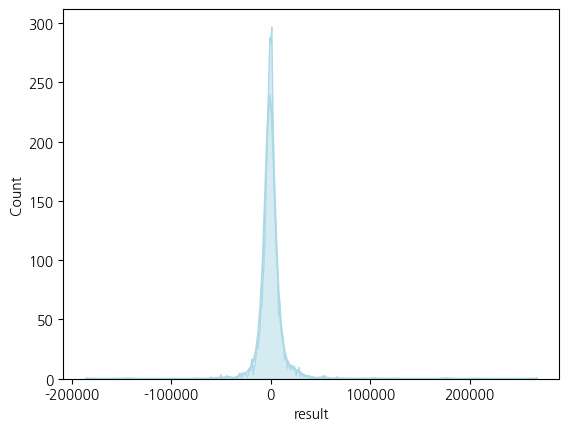

In [506]:
sns.histplot(data=resi,x='result',color='lightblue',element="poly",kde=True)
plt.show()

In [507]:
import scipy.stats as stats

In [508]:
F_statistic, pVal = stats.f_oneway(pred_results.predictions.flatten(),Y_valid.flatten())

print('Altman 910 데이터의 일원분산분석 결과 : F={0:.1f}, p={1:.5f}'.format(F_statistic, pVal))
if pVal < 0.05:
    print('P-value 값이 충분히 작음으로 인해 그룹의 평균값이 통계적으로 유의미하게 차이납니다.')

Altman 910 데이터의 일원분산분석 결과 : F=0.0, p=0.95063


### Parameter 시각화

In [420]:
# 모델 만들때 쓰인 data를 이용할 것. required data
display(len(required_data))
display(len(gwr_results.params))
# sample_data에 서울의 polygon이 들어있으므로 이를 활용하여 시각화하자.
visualization_data = required_data.copy()
visualization_data.head()

19153

19153

,TOT_REG_CD,BUS_NUM,BUS_AVG,SUB_NUM,SUB_DIS_POINT,SUB_AVG,SHOP_NUM,FACILITY_NUM,geometry,TOT_POP_GU_AVG,lon,lat
0,1101053010001,3,196.559140,4,24.0,0,7.0,16.0,"POLYGON ((126.96613 37.57496, 126.96632 37.574...",8940.096774,126.970311,37.578304
1,1101053010002,2,428.177419,3,27.0,52315,74.0,16.0,"POLYGON ((126.96877 37.57823, 126.96878 37.578...",44303.774190,126.965178,37.574151
2,1101053010003,12,497.196237,4,26.0,34690,37.0,26.0,"POLYGON ((126.96645 37.57883, 126.96647 37.578...",40190.290320,126.965513,37.576513
3,1101053010004,5,3152.083871,4,29.0,52315,113.0,22.0,"POLYGON ((126.97145 37.57734, 126.97147 37.577...",48889.806450,126.969002,37.577092
4,1101053010005,6,2136.021505,3,29.0,52315,122.0,24.0,"POLYGON ((126.97399 37.57823, 126.97400 37.578...",33499.483870,126.972772,37.578025


In [425]:
#Prepare GWR results for mapping

#Add GWR parameters to GeoDataframe
'''
1. 버스정류장수
2. 버스이용객 평균
3. 지하철 수
4. 지하철 거리점수
5. 지하철이용객 평균
6. 상가 수
7. 시설 수
8. 위도
9. 경도
'''
visualization_data['gwr_intercept'] = gwr_results.params[:,0]
visualization_data['gwr_bus_num'] = gwr_results.params[:,1]
visualization_data['gwr_bus_avg'] = gwr_results.params[:,2]
visualization_data['gwr_sub_num'] = gwr_results.params[:,3]
visualization_data['gwr_sub_dis_point'] = gwr_results.params[:,4]
visualization_data['gwr_sub_avg'] = gwr_results.params[:,5]
visualization_data['gwr_shop_num'] = gwr_results.params[:,6]
visualization_data['gwr_facility_num'] = gwr_results.params[:,7]

#Obtain t-vals filtered based on multiple testing correction
gwr_filtered_t = gwr_results.filter_tvals()

In [428]:
columns = ['geometry','gwr_intercept','gwr_bus_num','gwr_bus_avg','gwr_sub_num','gwr_sub_dis_point','gwr_sub_avg'
           ,'gwr_shop_num','gwr_facility_num']
s_geo_data = visualization_data.loc[:,columns]
s_geo_data = gp.GeoDataFrame(s_geo_data,geometry='geometry')

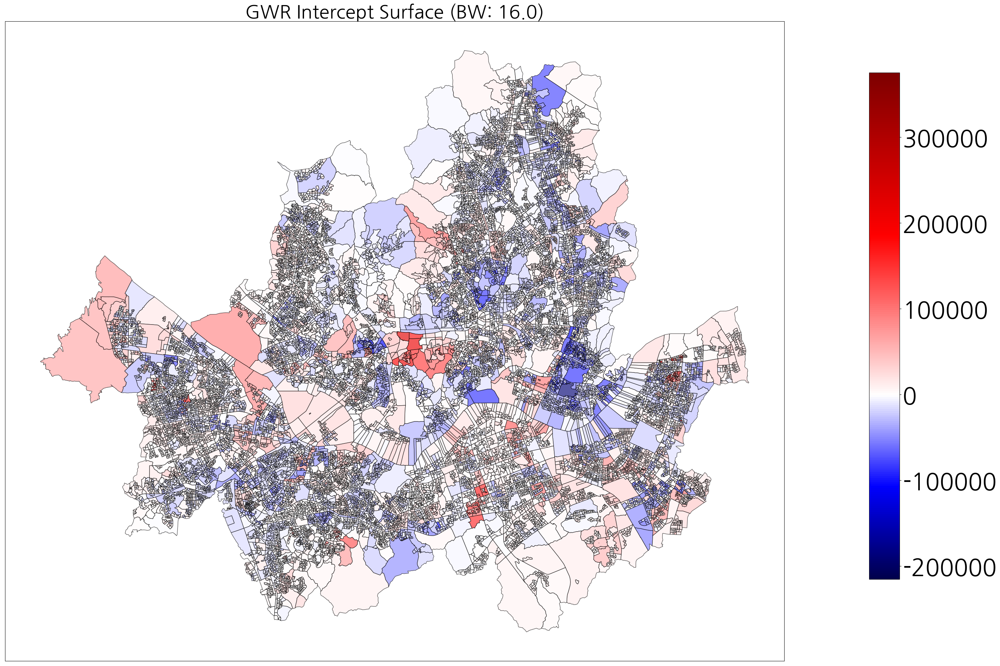

In [433]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR Intercept Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_intercept'].min()
vmax = s_geo_data['gwr_intercept'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

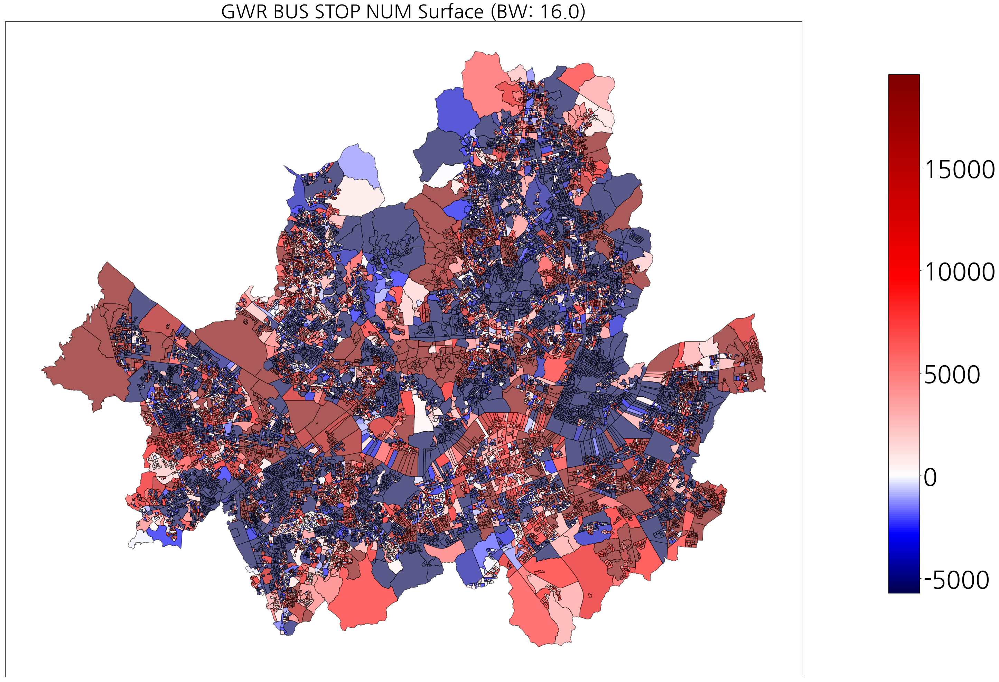

In [436]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR BUS STOP NUM Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_bus_num'].min()
vmax = s_geo_data['gwr_bus_num'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

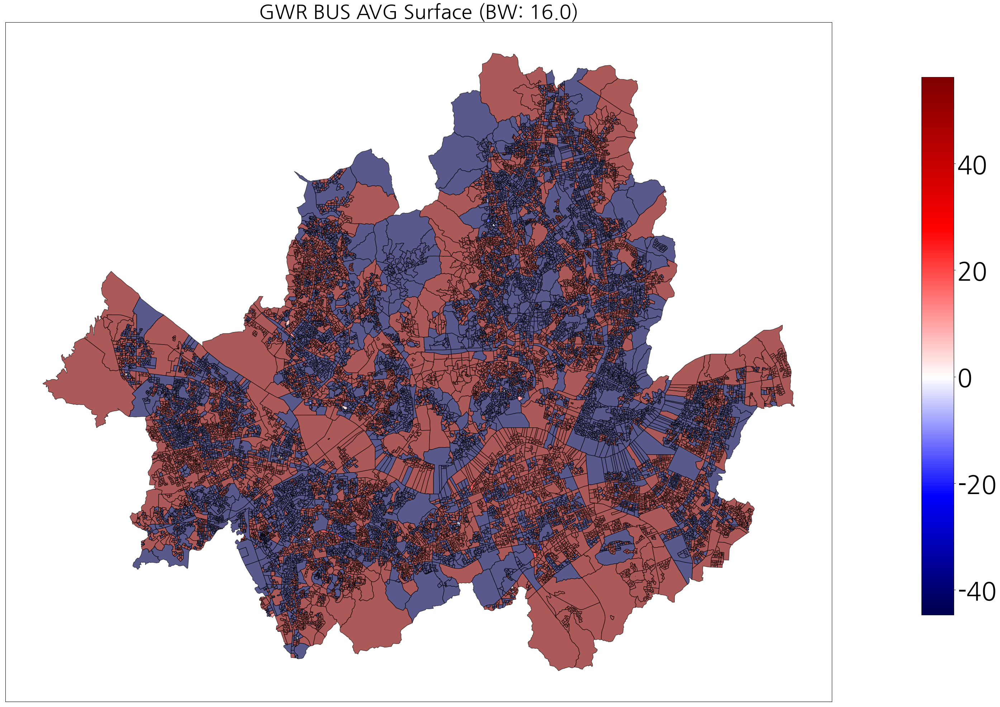

In [437]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR BUS AVG Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_bus_avg'].min()
vmax = s_geo_data['gwr_bus_avg'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

In [ ]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR SUBWAY NUM Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_sub_num'].min()
vmax = s_geo_data['gwr_sub_num'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

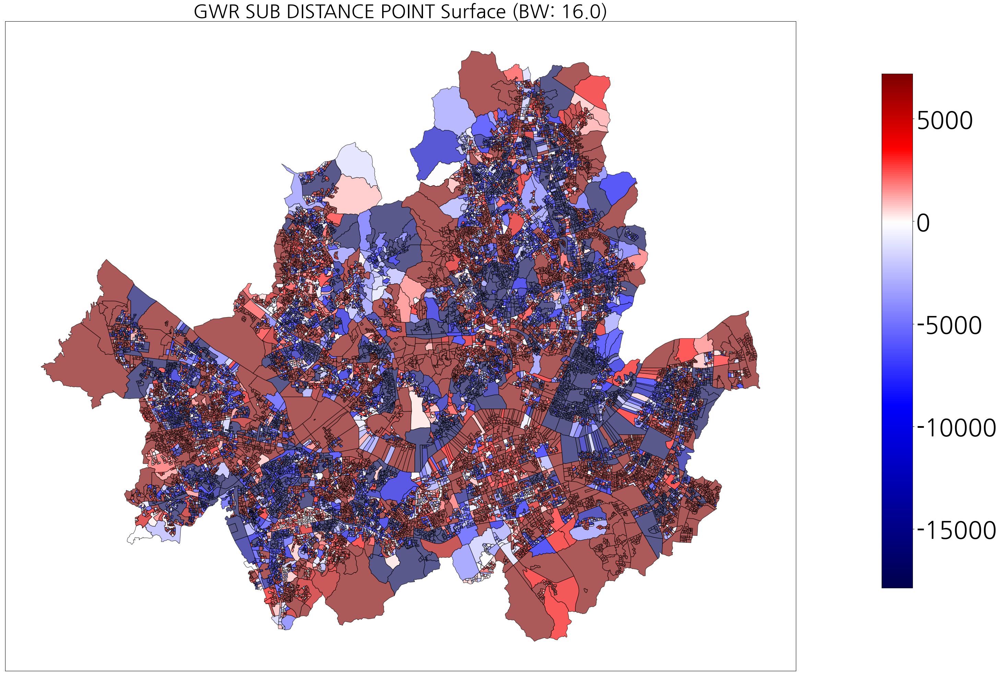

In [438]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR SUB DISTANCE POINT Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_sub_dis_point'].min()
vmax = s_geo_data['gwr_sub_dis_point'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

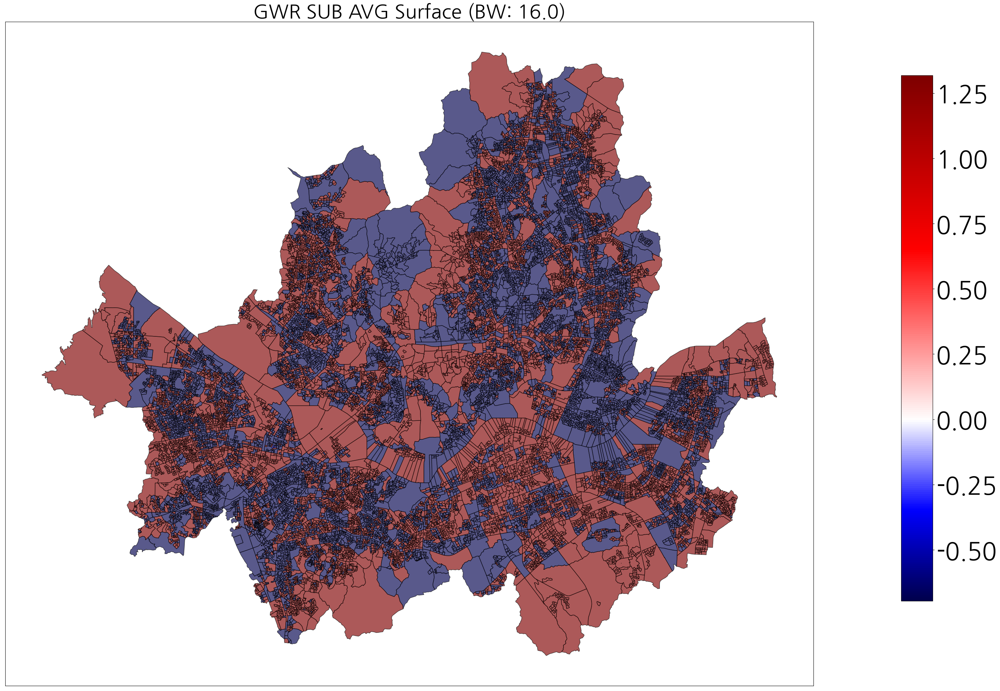

In [439]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR SUB AVG Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_sub_avg'].min()
vmax = s_geo_data['gwr_sub_avg'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

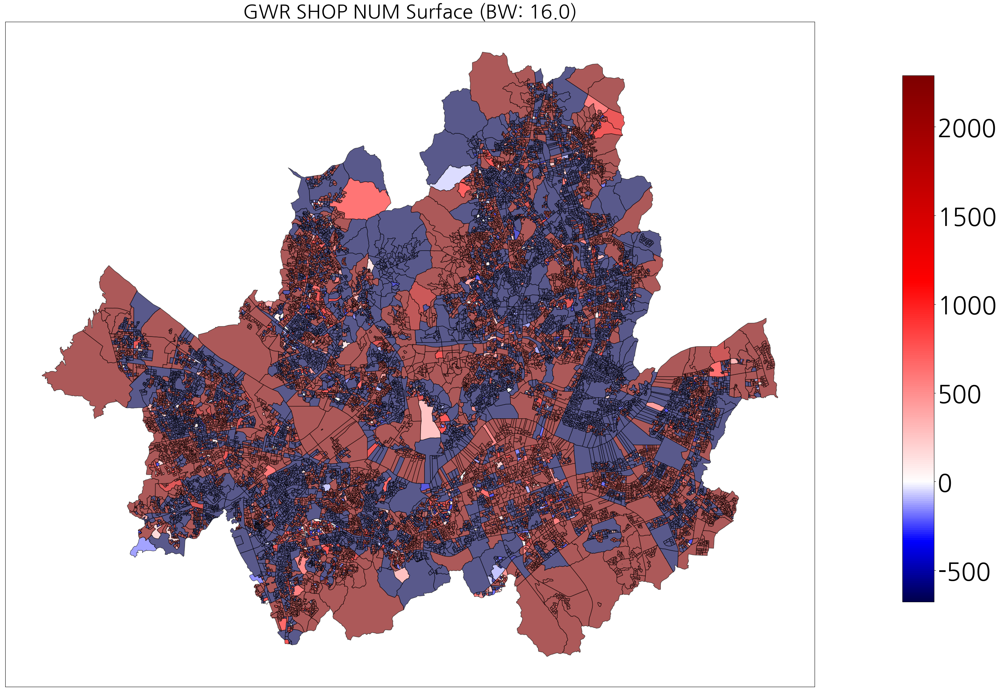

In [440]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR SHOP NUM Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_shop_num'].min()
vmax = s_geo_data['gwr_shop_num'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()

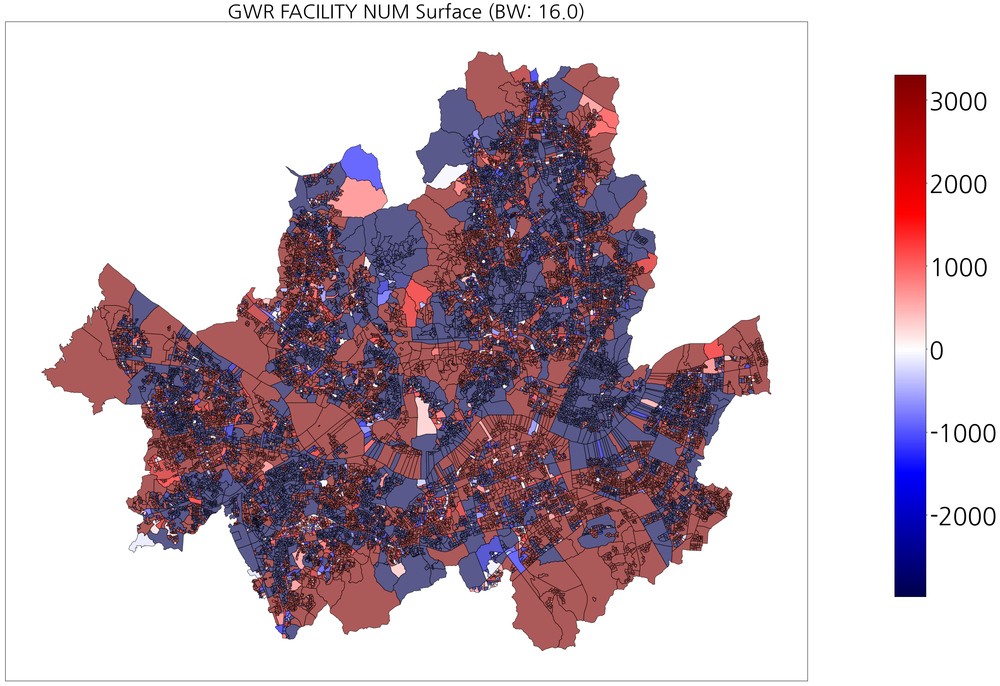

In [441]:
#Comparison maps of GWR vs. MGWR parameter surfaces where the grey units pertain to statistically insignificant parameters

#Prep plot and add axes
fig, ax = plt.subplots(1, figsize=(30,20))
ax.set_title('GWR FACILITY NUM Surface (BW: ' + str(gwr_bw) +')', fontsize=40)

#Set color map
cmap = plt.cm.seismic

#Find min and max values of the two combined datasets
vmin = s_geo_data['gwr_facility_num'].min()
vmax = s_geo_data['gwr_facility_num'].max()

#If all values are negative use the negative half of the colormap
if (vmin < 0) & (vmax < 0):
    cmap = truncate_colormap(cmap, 0.0, 0.5)
#If all values are positive use the positive half of the colormap
elif (vmin > 0) & (vmax > 0):
    cmap = truncate_colormap(cmap, 0.5, 1.0)
#Otherwise, there are positive and negative values so the colormap so zero is the midpoint
else:
    cmap = shift_colormap(cmap, start=0.0, midpoint=1 - vmax/(vmax + abs(vmin)), stop=1.)

#Create scalar mappable for colorbar and stretch colormap across range of data values
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))

#Plot GWR parameters
s_geo_data.plot('gwr_intercept', cmap=sm.cmap, ax=ax, vmin=vmin, vmax=vmax, **{'edgecolor':'black', 'alpha':.65})
#If there are insignificnt parameters plot gray polygons over them
# if (gwr_filtered_t[:,0] == 0).any():
#     s_geo_data[gwr_filtered_t[:,0] == 0].plot(color='lightgrey', ax=ax0, **{'edgecolor':'black'})
 
#Set figure options and plot 
fig.tight_layout()    
fig.subplots_adjust(right=0.9)
cax = fig.add_axes([0.92, 0.14, 0.03, 0.75])
sm._A = []
cbar = fig.colorbar(sm, cax=cax)
cbar.ax.tick_params(labelsize=50) 
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.show()